In [122]:
import urllib.request
import pandas as pd
import numpy as np
from datetime import datetime,timedelta,date

In [123]:
from IPython.display import display, HTML, Markdown

paramOpt=1
changeCSV=False
adjustParam=False
paramSave=False
selectDRS=False

In [124]:
dfSP = pd.read_csv("data/dados_municipios_SP.csv.gz",compression='gzip')
dfSP
dfSP.query('DRS == "{}"'.format('DRS 01 - Grande São Paulo'))

,date,state,city,place_type,confirmed,deaths,order_for_place,is_last,popEst,estimated_population,city_ibge_code,confirmed_per_100k_inhabitants,death_rate,DRS
9175,2020-12-31,SP,Arujá,city,2900,113,259,False,89824.0,91157.0,3503901.0,3181.32453,0.0390,DRS 01 - Grande São Paulo
9176,2020-12-29,SP,Arujá,city,2875,113,258,False,89824.0,91157.0,3503901.0,3153.89932,0.0393,DRS 01 - Grande São Paulo
9177,2020-12-28,SP,Arujá,city,2813,111,257,False,89824.0,91157.0,3503901.0,3085.88479,0.0395,DRS 01 - Grande São Paulo
9178,2020-12-27,SP,Arujá,city,2812,111,256,False,89824.0,91157.0,3503901.0,3084.78778,0.0395,DRS 01 - Grande São Paulo
9179,2020-12-24,SP,Arujá,city,2804,111,255,False,89824.0,91157.0,3503901.0,3076.01172,0.0396,DRS 01 - Grande São Paulo
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150078,2021-01-08,SP,Vargem Grande Paulista,city,864,35,266,False,52597.0,53468.0,3556453.0,1615.91980,0.0405,DRS 01 - Grande São Paulo
150079,2021-01-07,SP,Vargem Grande Paulista,city,859,35,265,False,52597.0,53468.0,3556453.0,1606.56841,0.0407,DRS 01 - Grande São Paulo
150080,2021-01-05,SP,Vargem Grande Paulista,city,841,35,264,False,52597.0,53468.0,3556453.0,1572.90342,0.0416,DRS 01 - Grande São Paulo
150081,2021-01-04,SP,Vargem Grande Paulista,city,838,34,263,False,52597.0,53468.0,3556453.0,1567.29259,0.0406,DRS 01 - Grande São Paulo


In [125]:
if paramOpt==0:
    paramFile="data/param.csv"
    version = "1"
    model = "ManualIC"
    
if paramOpt==1:
    paramFile="data/param_optimized_Yabox_HistMin.csv"
    version = "115"
    model = "YaboxIC" 

In [126]:
dfparam = pd.read_csv(paramFile)
dfparam = dfparam.dropna()
dfparam.e0=0
dfparam.r0=0

display(Markdown("## Original Initial Parameters"))
display(dfparam)

## Original Initial Parameters

,DRS,start-date,prediction-range,s0,e0,a0,i0,r0,d0,START,RATIO,WCASES,WREC
0,DRS 01 - Grande São Paulo,2020-03-17,200,11694971,0,0,145,0,41,110,0.15,0.1921,0.0
1,DRS 02 - Araçatuba,2020-04-04,200,380356,0,0,138,0,227,160,0.15,0.1918,0.0
2,DRS 03 - Araraquara,2020-03-31,200,494225,0,0,238,0,51,132,0.15,0.2041,0.0
3,DRS 04 - Baixada Santista,2020-03-28,200,1656381,0,0,85,0,151,39,0.15,0.2007,0.0
4,DRS 05 - Barretos,2020-03-30,200,179162,0,0,184,0,60,64,0.15,0.1979,0.0
5,DRS 06 - Bauru,2020-04-02,200,1581107,0,0,25,0,209,131,0.15,0.2020,0.0
6,DRS 07 - Campinas,2020-04-04,200,3725839,0,0,84,0,226,139,0.15,0.2171,0.0
7,DRS 08 - Franca,2020-04-04,200,291299,0,0,112,0,26,177,0.15,0.2081,0.0
8,DRS 09 - Marília,2020-04-03,200,660482,0,0,102,0,243,3,0.15,0.1987,0.0
9,DRS 10 - Piracicaba,2020-04-03,200,669522,0,0,234,0,199,168,0.15,0.2060,0.0


In [127]:
DRS=dfparam.DRS

In [128]:
allDistricts=True
cleanRecovered=False
version="9"

if allDistricts:
    display(DRS)
else:
    districtRegionSelected="DRS 13 - Ribeirão Preto"
    display(districtRegionSelected)

0          DRS 01 - Grande São Paulo
1                 DRS 02 - Araçatuba
2                DRS 03 - Araraquara
3          DRS 04 - Baixada Santista
4                  DRS 05 - Barretos
5                     DRS 06 - Bauru
6                  DRS 07 - Campinas
7                    DRS 08 - Franca
8                   DRS 09 - Marília
9                DRS 10 - Piracicaba
10      DRS 11 - Presidente Prudente
11                 DRS 12 - Registro
12           DRS 13 - Ribeirão Preto
13    DRS 14 - São João da Boa Vista
14    DRS 15 - São José do Rio Preto
15                 DRS 16 - Sorocaba
16                  DRS 17 - Taubaté
Name: DRS, dtype: object

In [129]:
%matplotlib inline 
import matplotlib.pyplot as plt
import pandas as pd
%reload_ext autoreload
%autoreload 2
import covid_plots_v2 as covid_plots
%config InlineBackend.figure_format ='retina'

In [130]:
#DRS 01 - Grande São Paulo
#DRS 02 - Araçatuba
#DRS 03 - Araraquara
#DRS 04 - Baixada Santista
#DRS 05 - Barretos
#DRS 06 - Bauru
#DRS 07 - Campinas
#DRS 08 - Franca
#DRS 09 - Marília
#DRS 10 - Piracicaba
#DRS 11 - Presidente Prudente
#DRS 12 - Registro
#DRS 13 - Ribeirão Preto
#DRS 14 - São João da Boa Vista
#DRS 15 - São José do Rio Preto
#DRS 16 - Sorocaba
#DRS 17 - Taubaté

#main district region for analysis
districtRegion = "DRS 01 - Grande São Paulo"

#select districts for plotting
districts4Plot=['DRS 10 - Piracicaba',
               'DRS 04 - Baixada Santista',
               'DRS 07 - Campinas',
               'DRS 02 - Araçatuba',
               districtRegion]


#Choose here your options
#opt=0 all plots
#opt=1 corona log plot
#opt=2 logistic model prediction
#opt=3 bar plot with growth rate
#opt=4 log plot + bar plot
#opt=5 SEAIR-D Model
opt = 5

#number of cases to start plotting model in log graph - real data = 100
startCase=100

#all DRS for plotting
DRS=dfparam.DRS

In [131]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines){
    return false;}

<IPython.core.display.Javascript object>

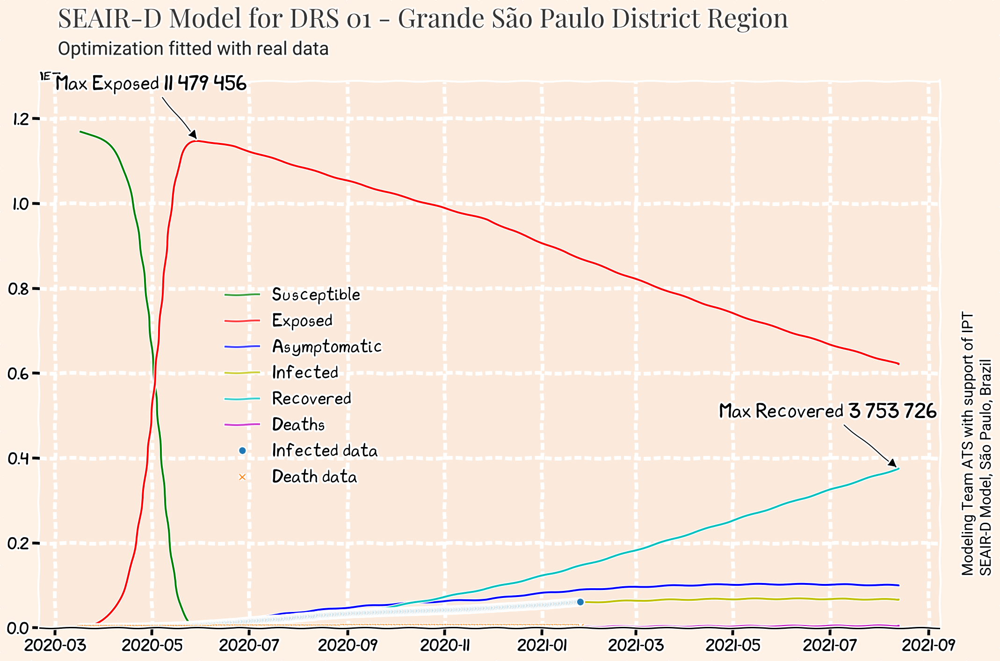

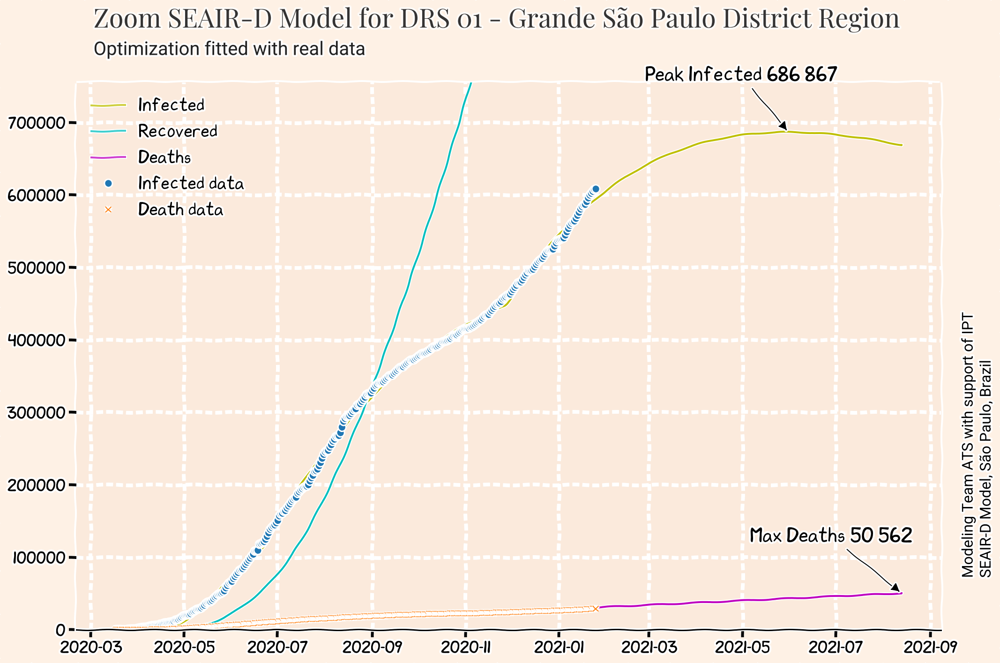

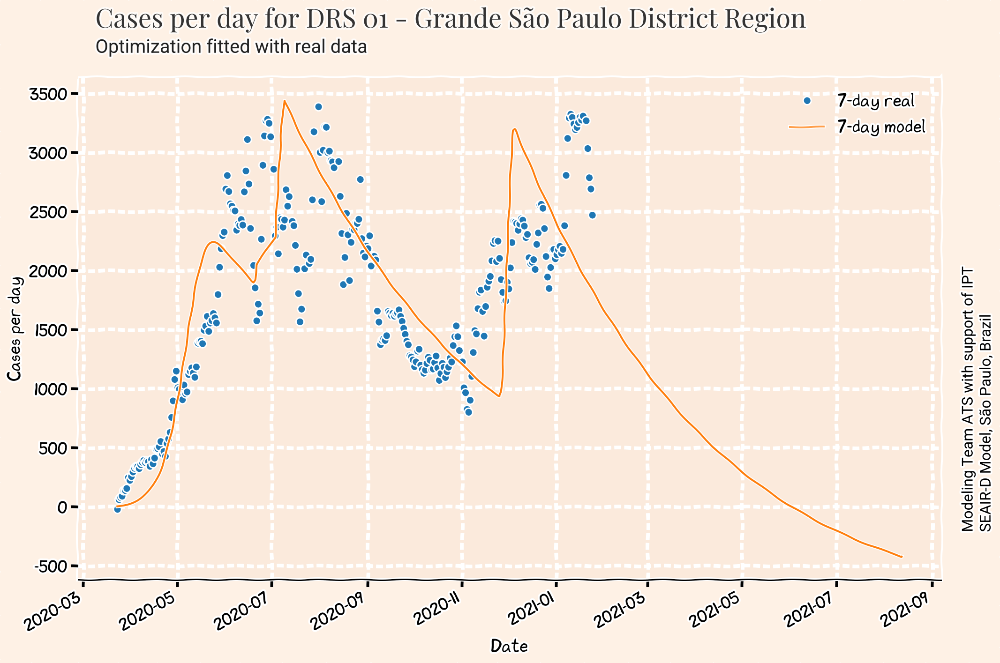

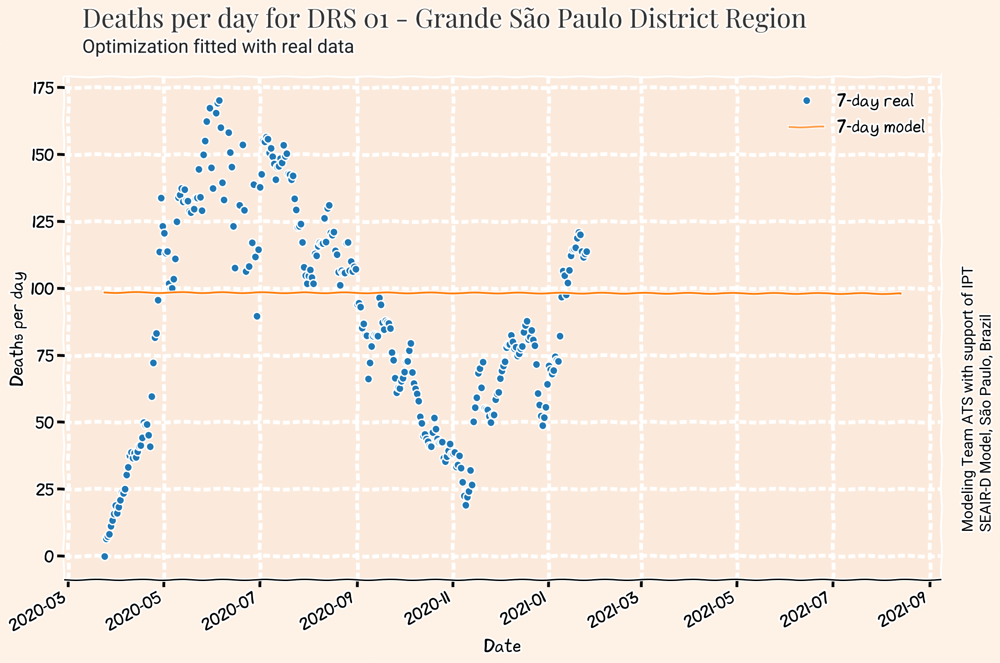

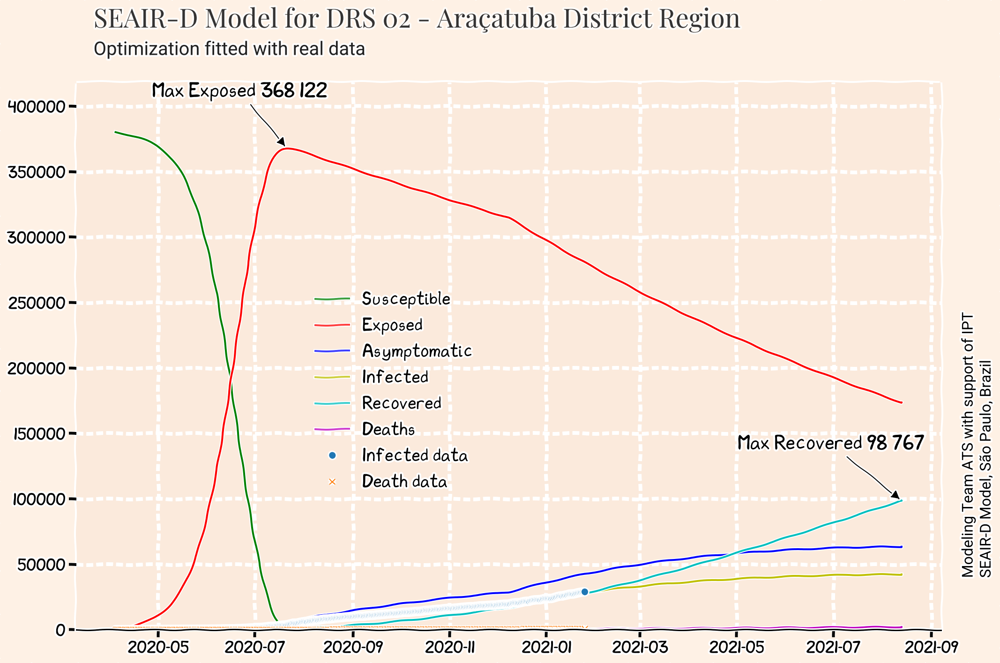

...

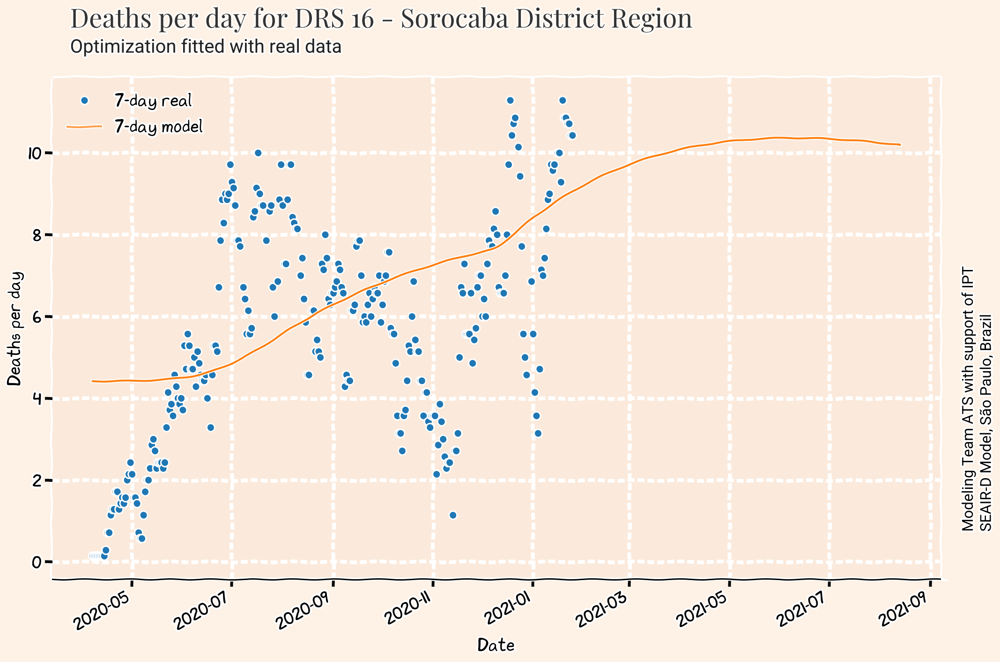

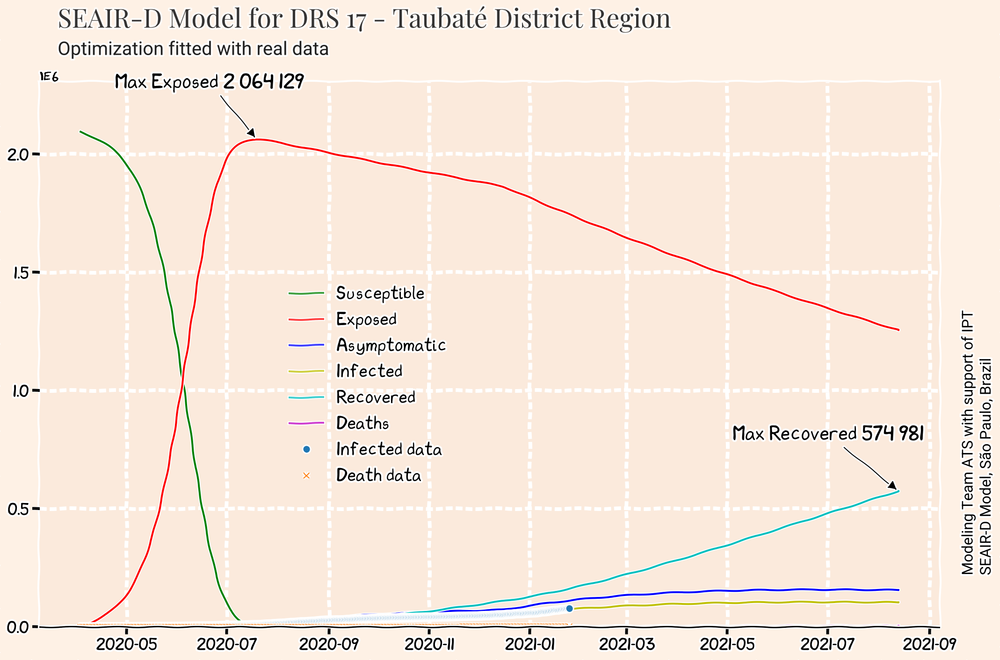

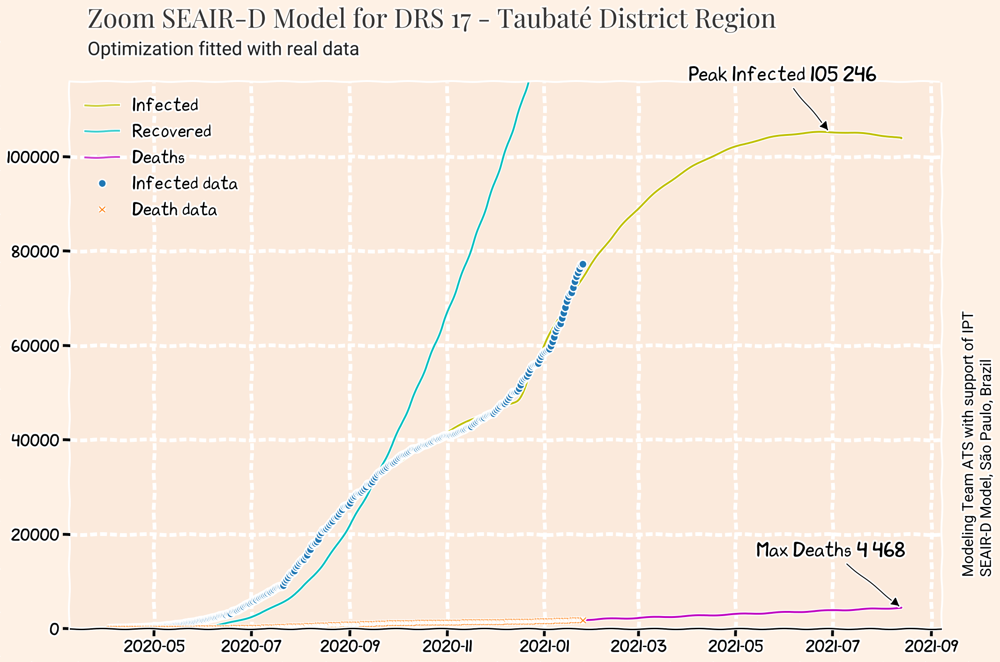

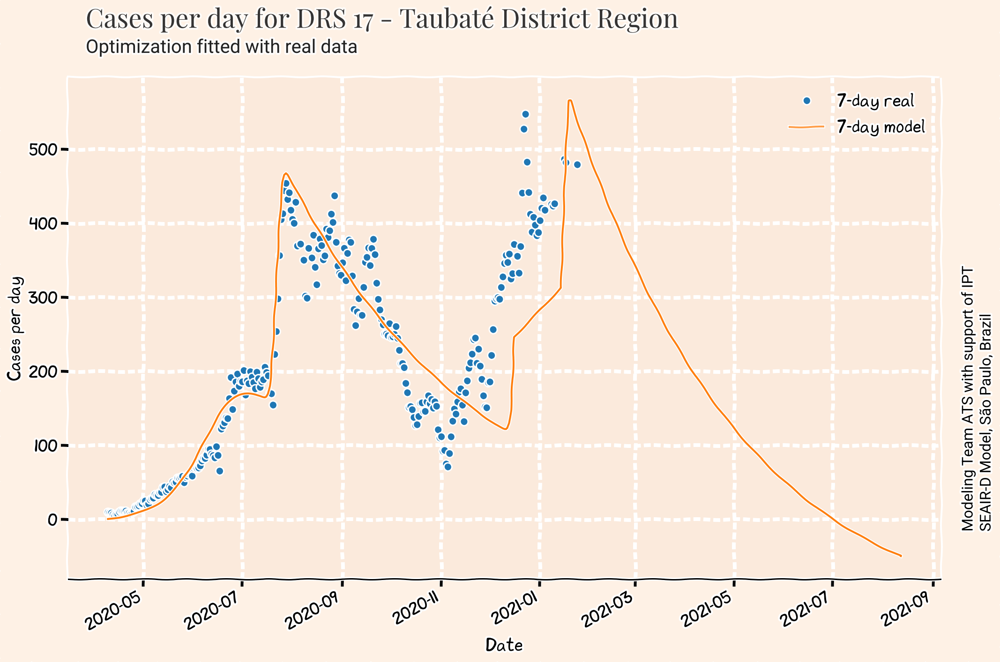

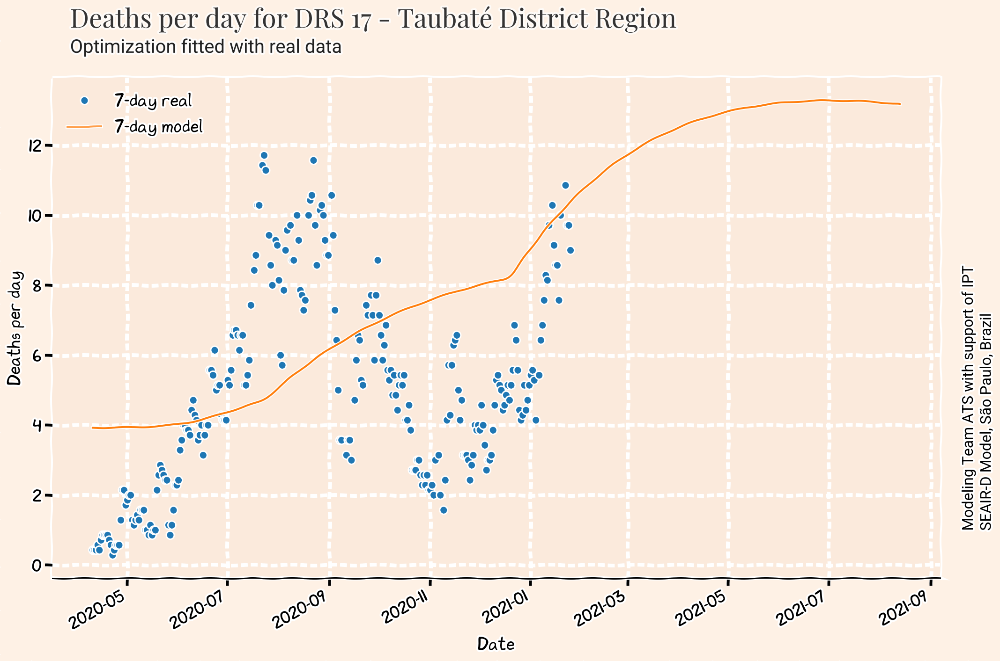

In [132]:
selectLastDate=False

#plots one district or all districts  
if opt==5:
    allDistricts=True
else:
    allDistricts=False
    
if not allDistricts:
    DRS=[districtRegion]
        
for districtRegion in DRS:
    query = dfparam.query('DRS == "{}"'.format(districtRegion)).reset_index()
    ratio = query['RATIO'][0]
    startCase = query['START'][0]
    startdate = query['start-date'][0]
    predict_range = query['prediction-range'][0]

    #calcula data máxima dos gráficos
    #100 dias é usado como máximo dos cálculos da derivada das mortes
    if selectLastDate:
        lastDate="2021-01-18"
    else:
        lastDate=dfSP.date.max()
    maxDate= datetime.strptime(lastDate, "%Y-%m-%d") + timedelta(days = 300) #"2020-08-31"
    maxDateStr = maxDate.strftime("%Y-%m-%d")

    covid_plots.covid_plots(districtRegion, districts4Plot, startdate, predict_range, \
                    startCase, opt, version, show=True, ratio=ratio, maxDate=maxDateStr, model=model,lastDate=lastDate)